<a href="https://colab.research.google.com/github/DimIsaev/Datasets/blob/main/OCR_Pocker_OpenCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

еще ссылки  https://github.com/terukusu/poker-card-reader/blob/master/main.py  https://github.com/naderchehab/card-detector/blob/master/main.py

In [1]:
!pip install opencv-contrib-python -U
!pip install opencv-python -U
!apt install -qq tesseract-ocr -y
!apt-get install -qq tesseract-ocr-rus -y
!pip install -q pytesseract

     |████████████████████████████████| 56.1 MB 30 kB/s 
  Attempting uninstall: opencv-contrib-python
    Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30
     |████████████████████████████████| 49.9 MB 17 kB/s 
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.1.2.30
    Uninstalling opencv-python-4.1.2.30:
      Successfully uninstalled opencv-python-4.1.2.30
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following additional packages will be installed:
  tesseract

In [57]:
import numpy as np
from scipy import spatial
import cv2
import os
import pytesseract
pytesseract.pytesseract.tesseract_cmd = r'/usr/bin/tesseract'
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (25, 15)
import re

In [61]:
frame = cv2.imread('2_5.png')
#frame = cv2.imread('11.png')

#img = cv2.imread('tmp/cards/main/as.png', cv2.IMREAD_UNCHANGED)
print(frame.shape)

(1070, 1421, 3)


In [4]:
# %%time
cards = []
directory = r'cards'
for card in os.listdir(directory):
  path_card = os.path.join(directory, card)
  crd = cv2.imread(path_card, 0)
  cards.append([card.split('.')[0], crd])


area_players = (200, 230)
coord_players = [
            (595,747),
            (5,561),                        
            (52,125),                        
            (595,18),                                                
            (1135,125),                        
            (1185,564),                        
]
coord_flop = [350, 380, 1035, 570]
coord_flop_bet = [570, 350, 870, 380]
buttons = [
    (835,916,980,1000),
    (1030,916,1175,1000),
    (1220,916,1365,1000),
   ]


In [ ]:
a = frame.copy()


A = np.array(coord_players)
distance,index = spatial.KDTree(A).query(coord_diler[0])

print(names[index])

cv2.putText(a, f'{names[index]}', (coord_diler[0][0], coord_diler[0][1] - 18), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

plotting = plt.imshow(a)
plt.show()

In [37]:
def ocr_text(image):
  text = ''
  blur = cv2.GaussianBlur(image, (1, 1), 0)
  gray  = cv2.cvtColor(blur, cv2.COLOR_BGR2GRAY)
  thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
  res = 255 - thresh

  custom_config = f'--oem 3 --psm 6'
  text = pytesseract.image_to_string(res, config = custom_config)
  text = post_process_ocr(text)
  print("OCR text:", text)

  # bin  = cv2.cvtColor(res, cv2.COLOR_BGR2RGB)
  # plotting = plt.imshow(res)
  # plt.show()
 
  return text

def post_process_ocr(out):

  out = out.replace('\r', '')
  out = out.replace('|', '')
  out = out.replace('-\n', '')
  out = out.replace('\n$', '')
  out = out.replace('\n+', '')
  out = out.replace('\n', ' ')
  out = out.replace('\f', '')
  out = out.replace('\s+', ' ')
  out = out.strip()
  return out

************************************************************
OCR text: staspushka
staspushka
OCR text: $0.96
$0.96
************************************************************
OCR text: west630
west630
OCR text: $1.65
$1.65
************************************************************
OCR text: naihe Bridge
naihe Bridge
OCR text: $0.50
$0.50
************************************************************
OCR text: jinshaboboa
jinshaboboa
OCR text: $2.24
$2.24
************************************************************
OCR text: Poks Virtual
Poks Virtual
OCR text: $2.89
$2.89
************************************************************
OCR text: abigail666
abigail666
OCR text: $2.68
$2.68
OCR text: Total Pot : $0.04
card: js [541, 14, 653, 169]
card: js [416, 14, 527, 169]
card: as [288, 14, 399, 181]
card: 9c [160, 14, 271, 169]
card: jh [32, 14, 143, 169]
card: 9c [0, 0, 685, 190]
(84, 145, 3)
OCR text: Check / Fold
(84, 145, 3)
OCR text: Check
(84, 145, 3)
OCR text: Bet0.02
abigail666


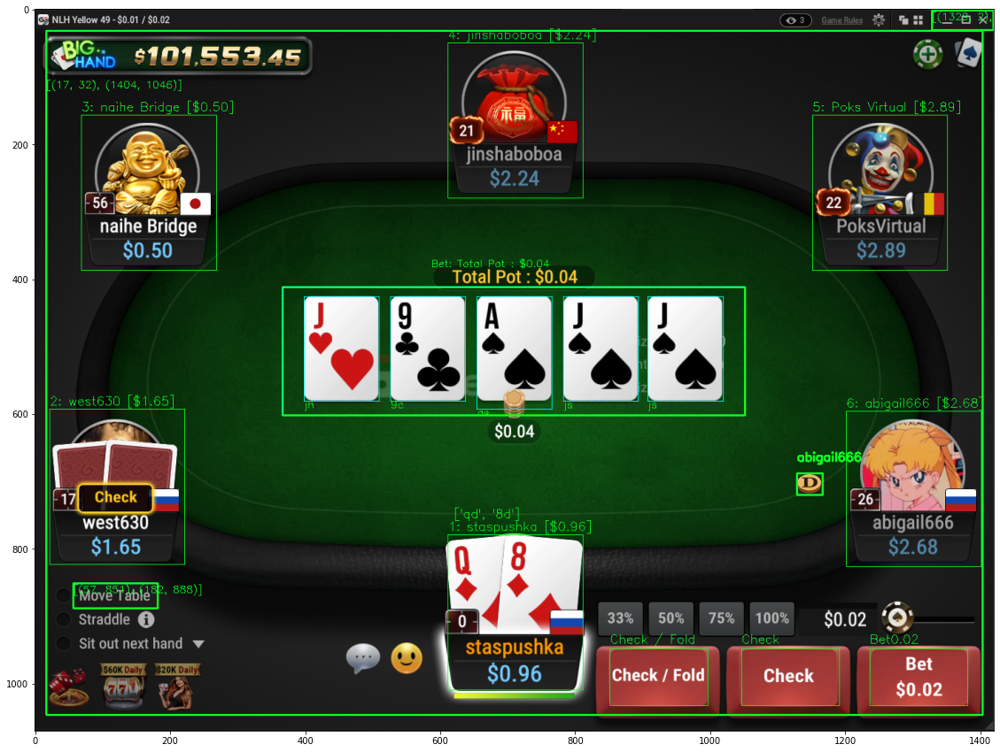

In [62]:
img = frame.copy()

threshold = 0.76
rt = 'rt_1.png'
lb = 'lb_1.png'
diler = 'diler.png'
color = (36, 255, 12)

template_rt = cv2.imread(rt,0)
template_lb = cv2.imread(lb,0)
template_diler = cv2.imread(diler,0)

# coridanates left bottom
coord_rt = find_coord(img, template_rt)
cv2.rectangle(img, coord_rt[0], coord_rt[1], color, 2)
cv2.putText(img, f'{coord_rt}', (coord_rt[0][0], coord_rt[0][1] + 14), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

# coridanates left bottom
coord_lb = find_coord(img, template_lb)
cv2.rectangle(img, coord_lb[0], coord_lb[1], color, 2)
cv2.putText(img, f'{coord_lb}', (coord_lb[0][0], coord_lb[0][1] + 14), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

# coridanates screen
coord_screen =  [(coord_lb[0][0] - 40 , coord_rt[0][1] + 30), (coord_rt[0][0] + 75, coord_lb[0][1] + 195)]
cv2.rectangle(img, coord_screen[0], coord_screen[1], color, 2)
cv2.putText(img, f'{coord_screen}', (coord_screen[0][0], coord_screen[0][1] + 85), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

# OCR data players
names = []
bets = []

for i,coord in enumerate(coord_players):
  x_ = coord[0] + 10 + coord_screen[0][0]
  x2_ = coord[0] - 10 + area_players[0]+coord_screen[0][0]
  y_ = coord[1] + 152 + coord_screen[0][1]
  y2_ = coord[1]+ area_players[1] - 48 +coord_screen[0][1]

  # name
  area_name = img[y_:y2_, x_+15:x2_-15].copy()
  print('*'*60)
  name = ocr_text(area_name)
  names.append(name)
  print(name)

  # bet
  area_bet = img[y_+34:y2_+38, x_+10:x2_-10].copy()
  bet = ocr_text(area_bet)
  bets.append(bet)
  print(bet)

  cv2.rectangle(img, (coord[0] + coord_screen[0][0], coord[1] + coord_screen[0][1]),
               (coord[0] + coord_screen[0][0] + area_players[0], coord[1] + coord_screen[0][1] + area_players[1]), color, 1)
  cv2.putText(img, f'{i+1}: {name} [{bet}]', (coord[0] + coord_screen[0][0], coord[1] + coord_screen[0][1] - 6), 
                cv2.FONT_HERSHEY_SIMPLEX, 0.6, (36, 255, 12), 1)

# flop bet 
x_bet = coord_flop_bet[0]+coord_screen[0][0]
x2_bet = coord_flop_bet[2]+coord_screen[0][0]
y_bet = coord_flop_bet[1]+coord_screen[0][1]
y2_bet = coord_flop_bet[3]+coord_screen[0][1]
flop_bet = img[y_bet:y2_bet, x_bet:x2_bet]
#print(y_bet,y2_bet, x_bet,x2_bet)

text_bet = ocr_text(flop_bet)

cv2.putText(img, f'Bet: {text_bet}', (x_bet, y_bet), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

# coordinate flop 
cv2.rectangle(img, (coord_flop[0] + coord_screen[0][0], coord_flop[1] + coord_screen[0][1]), 
              (coord_flop[2] + coord_screen[0][0], coord_flop[3] + coord_screen[0][1] ), color, 2)

# flop OCR cards name
x = coord_flop[0] + coord_screen[0][0]
y = coord_flop[1] + coord_screen[0][1]
x2 = coord_flop[2] + coord_screen[0][0]
y2 = coord_flop[3] + coord_screen[0][1]

flop = img[y:y2, x:x2]
gray_main_image = cv2.cvtColor(flop.copy(), cv2.COLOR_BGR2GRAY)
contours = find_contours_of_cards(gray_main_image)
cards_location = find_coordinates_of_cards(contours, gray_main_image)
flob_b = draw_rectangle_aroud_cards(cards_location, flop.copy())
img[y:y2, x:x2] = flob_b

flop_cards = []
for card, c in cards_location:
  flop_cards.append(card)

#cv2.putText(img, f'{flop_cards}', (x, y2 + 20), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 1)

# my cards
coord_my_cards = coord_players[0]
x_mc1 = coord_my_cards[0] + coord_screen[0][0]
x2_mc1 = coord_my_cards[0] + area_players[0] - 120 + coord_screen[0][0]
y_mc1 = coord_my_cards[1]  + coord_screen[0][1]
y2_mc1 = coord_my_cards[1] + area_players[1] - 120 + coord_screen[0][1]

area_my_cards_1 = img[y_mc1:y2_mc1, x_mc1:x2_mc1].copy()

x_mc2 = coord_my_cards[0] + coord_screen[0][0]  + 80
x2_mc2 = coord_my_cards[0] + area_players[0] + coord_screen[0][0]
y_mc2 = coord_my_cards[1]  + coord_screen[0][1]
y2_mc2 = coord_my_cards[1] + area_players[1] - 120 + coord_screen[0][1]

area_my_cards_2 = img[y_mc2:y2_mc2, x_mc2:x2_mc2].copy()

my_cards = []

for i, area_ in enumerate([area_my_cards_1, area_my_cards_2]):

  gray_main_image = cv2.cvtColor(area_.copy(), cv2.COLOR_BGR2GRAY)
  contours = find_contours_of_cards(gray_main_image)
  cards_location = find_coordinates_of_cards(contours, gray_main_image)
  my_cards.append(cards_location[0][0])

cv2.putText(img, f'{my_cards}', (x_1, y_1 - 25), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 1)


# button
for i, button  in enumerate(buttons):

  x_b = button[0] + coord_screen[0][0]
  y_b = button[1] + coord_screen[0][1]
  x2_b = button[2] + coord_screen[0][0]
  y2_b = button[3] + coord_screen[0][1]

  cv2.rectangle(img, (x_b, y_b), (x2_b, y2_b), color, 1)
  area_button = img[y_b:y2_b, x_b:x2_b].copy()

  print(area_button.shape)
  t = ocr_text(area_button)    

  cv2.putText(img, f'{t}', (x_b, y_b - 8), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 1)

# coordinate diler
coord_diler = find_coord(img, template_diler)
cv2.rectangle(img, coord_diler[0], coord_diler[1], color, 2)
# cv2.putText(img, f'{coord_diler}', (coord_diler[0][0], coord_diler[0][1] + 24), 
              #  cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 1)

A = np.array(coord_players)
distance,index = spatial.KDTree(A).query(coord_diler[0])

print(names[index])

cv2.putText(img, f'{names[index]}', (coord_diler[0][0], coord_diler[0][1] - 18), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)


rgb_image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plotting = plt.imshow(rgb_image)
plt.show()

In [39]:
def find_coord(img, template):

  img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
  min_val, max_val, min_indx, max_indx = cv2.minMaxLoc(res)
  # print(min_val,max_val,min_indx,max_indx)    
  return [max_indx, (max_indx[0]+template.shape[1], max_indx[1] + template.shape[0])]


def find_features(img1):
  correct_matches_dct = {}

  for card_name, img2 in cards:
    # path_image = os.path.join(directory, image)
    # img2 = cv2.imread(path_image, 0)
    # print(path_image)
  
    # orb = cv2.ORB_create()
    # kp1, des1 = orb.detectAndCompute(img1, None)
    # kp2, des2 = orb.detectAndCompute(img2, None)
    # bf = cv2.BFMatcher()
    # # bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=False)
    # matches = bf.knnMatch(des1, des2, k=2)

    detector = cv2.SIFT_create()
    #detector = cv2.xfeatures2d_SURF.create(hessianThreshold=minHessian)
    keypoints1, descriptors1 = detector.detectAndCompute(img1, None)
    keypoints2, descriptors2 = detector.detectAndCompute(img2, None)

    #-- Step 2: Matching descriptor vectors with a FLANN based matcher
    # Since SURF is a floating-point descriptor NORM_L2 is used
    matcher = cv2.DescriptorMatcher_create(cv2.DescriptorMatcher_FLANNBASED)
    matches = matcher.knnMatch(descriptors1, descriptors2, 2)

    correct_matches = []
    for m, n in matches:
      if m.distance < 0.75 * n.distance:
        correct_matches.append([m])
        #correct_matches_dct[image.split('.')[0]] = len(correct_matches)
        correct_matches_dct[card_name] = len(correct_matches)

        # img3 = cv2.drawMatchesKnn(img1, keypoints1, img2, keypoints2, correct_matches, None, flags=2)
        # plt.imshow(img3)
        # plt.title( f"{image.split('.')[0]}  {len(correct_matches)}" )
        # plt.show()
        # print(f"{card_name}  {len(correct_matches)}")    

  correct_matches_dct = dict(sorted(correct_matches_dct.items(),
                             key=lambda item: item[1], reverse=True))
  key_best =  list(correct_matches_dct.keys())[0]
  # print("ключ лучшего: ", key_best )

  return list(correct_matches_dct.keys())[0]


def find_contours_of_cards(image):
  blurred = cv2.GaussianBlur(image, (5, 5), 0)
  T, thresh_img = cv2.threshold(blurred, 127, 255, cv2.THRESH_BINARY)
  (cnts, _) = cv2.findContours(thresh_img, cv2.RETR_EXTERNAL,
                                  cv2.CHAIN_APPROX_SIMPLE)
  # plotting = plt.imshow(thresh_img)
  # plt.show()
  # print(len(cnts))
  return cnts


def find_coordinates_of_cards(cnts, image):
  cards_coordinates = []
  с = 5
  img_cnt = image.copy()
  for i in range(0, len(cnts)):
    x, y, w, h = cv2.boundingRect(cnts[i])
    img_cnt = cv2.rectangle(img_cnt,
              (x, y), (x+w, y+h), (255, 128, 0), 1)

    if w > 40 and h > 80:
      # print(i, ': ', x, y, w, h)          
      img_crop = image[y:y + h, x:x + w]
      cards_name = find_features(img_crop)
      cards_coordinates.append([cards_name, [x, y, x + w, y + h]])
  return cards_coordinates


def draw_rectangle_aroud_cards(cards_coordinates, image):
  
  img_crd = image.copy()
  for card_name, coord in cards_coordinates:
      print(f'card: {card_name} {coord}')
      cv2.rectangle(
          img_crd, (coord[0], coord[1]), (coord[2], coord[3]), (255, 255, 0), 1)
      cv2.putText(img_crd, card_name, (coord[0], coord[3] + 10),
                  cv2.FONT_HERSHEY_SIMPLEX, 0.5, (36, 255, 12), 1)
  # image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  
  return img_crd




---



In [ ]:
def init_img(x,y,w,h):# размер flop
  # hand 1
  # x,y = 620, 800
  # w,h = 120, 140

  d = 5

  image = cv2.imread('2_5.png')
  flop = image[y-d:y+h+d, x-d:x+w+d]
  plotting = plt.imshow(flop)
  plt.show()
  return flop

---
#### ♣️ Трефы — clubs  ♦️ Бубны — diamonds ♥️ Червы — hearts ♠️ Пики — spades
--- 
«В» = «J» — Jack  «Д» = «Q» — Queen  «К» = «K» — King «Т» = «A» — Ace

In [ ]:

#flop = init_img(398, 425, 621, 130)
flop = init_img(365, 370, 1035, 580)
plotting = plt.imshow(flop)
plt.show()

gray_main_image = cv2.cvtColor(flop, cv2.COLOR_BGR2GRAY)
# gray_main_image = image[y-d:y+h+d, x-d:x+w+d]
contours = find_contours_of_cards(gray_main_image)
cards_location = find_coordinates_of_cards(contours, gray_main_image)
draw_rectangle_aroud_cards(cards_location, flop)


In [ ]:
def resized(image,scale_percent):
  # percent of original size
  width = int(img.shape[1] * scale_percent / 100)
  height = int(img.shape[0] * scale_percent / 100)
  dim = (width, height)
  
  # resize image
  resized = cv2.resize(img, dim, interpolation = cv2.INTER_AREA)
  print('Resized Dimensions : ',resized.shape)
  return resized

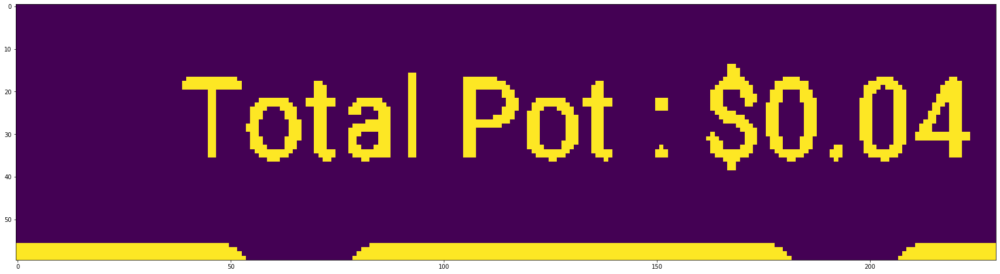

Total Pot : $0.04
(60, 230, 3)


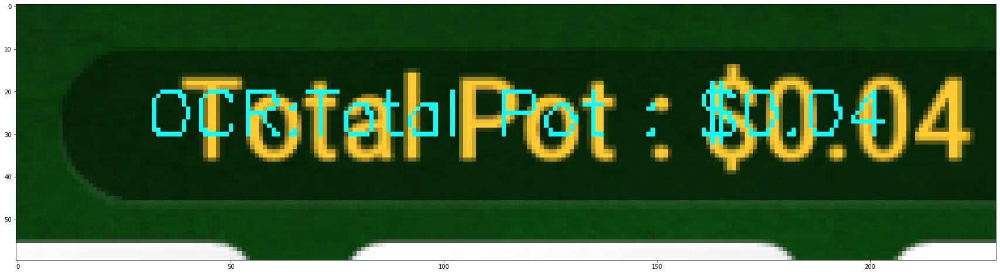

In [ ]:
img = frame.copy()
# total pot
x,y,w,h = (580, 370, 230, 60)
flop = img[y:y+h, x:x+w]

gray_main_image = cv2.cvtColor(flop, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray_main_image, (1, 1), 0)
T, thresh_img = cv2.threshold(blurred, 120, 255, cv2.THRESH_BINARY)
plotting = plt.imshow(thresh_img)
plt.show()

text = pytesseract.image_to_string(thresh_img, config = '--psm 6')
print(post_process_ocr(text))
text = post_process_ocr(text)
print(flop.shape)
cv2.putText(flop, f'OCR:{text}', (30, 30),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 12), 1)
rgb_image = cv2.cvtColor(flop, cv2.COLOR_BGR2RGB)
plotting = plt.imshow(rgb_image)
plt.show()


In [ ]:
from __future__ import print_function
import cv2 as cv
import numpy as np
img = cv2.imread(cv2.samples.findFile('/content/2_5.png'), cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread(cv2.samples.findFile('/content/cards/js.jpg'), cv2.IMREAD_GRAYSCALE)

# размер flop
x,y = 398, 425 
w,h = 621, 157
d = 100
img1  = img[y-d:y+h+d, x-d:x+w+d]


if img1 is None or img2 is None:
    print('Could not open or find the images!')
    exit(0)
#-- Step 1: Detect the keypoints using SURF Detector, compute the descriptors
minHessian = 400

detector = cv2.SIFT_create()
#detector = cv2.xfeatures2d_SURF.create(hessianThreshold=minHessian)
keypoints1, descriptors1 = detector.detectAndCompute(img1, None)
keypoints2, descriptors2 = detector.detectAndCompute(img2, None)

#-- Step 2: Matching descriptor vectors with a FLANN based matcher
# Since SURF is a floating-point descriptor NORM_L2 is used
matcher = cv2.DescriptorMatcher_create(cv2.DescriptorMatcher_FLANNBASED)
knn_matches = matcher.knnMatch(descriptors1, descriptors2, 2)

#-- Filter matches using the Lowe's ratio test
ratio_thresh = 0.7
good_matches = []
for m,n in knn_matches:
    if m.distance < ratio_thresh * n.distance:
        good_matches.append(m)
#-- Draw matches
img_matches = np.empty((max(img1.shape[0], img2.shape[0]), img1.shape[1]+img2.shape[1], 3), dtype=np.uint8)
cv2.drawMatches(img1, keypoints1, img2, keypoints2, good_matches, img_matches, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
#-- Show detected matches

# cv2.imshow('Good Matches', img_matches)

plotting = plt.imshow(img_matches)
plt.show()



In [ ]:
def init_img(x,y,w,h):# размер flop
  image = cv2.imread('/content/doc02982820210726074324_018 copy.jpg')
  #image = cv2.imread('/content/doc02982820210726074324_018 copy.jpg')
  # crop = image[y:y+h, x:x+w]
  plotting = plt.imshow(crop)
  plt.show()
  return crop 

In [ ]:
image = init_img(0, 10, 2238, 550)
pytesseract.image_to_string(image, config = '-l rus --psm 3')

In [ ]:
 image = cv2.imread('/content/doc02982820210726074324_009 — копия.jpg')

In [ ]:
res = cv2.GaussianBlur(image,(1,1), 0)

In [ ]:
text = pytesseract.image_to_string(res, config = '-l rus --psm 6')
print(text)

^ переванный” | Счетфакура м” 700 от Имя) ооо | р пион пы гооо орниооабрзоНи  Н
документ Исправление № от = (1а) } }
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г, Ленина ул, дом 182, корпус 4, офис 23 (2а)
ИННИКПП продавца: 9710008385/324501001 (26)
1 - счет-фактура и ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ "ТЕХПРОМ", 614014, Пермский край, Мотовилихинский р-н, Пермь г, Соликамская ул,
ый АокУмеНт | Грузоотправитель и его адрес: дом № 271А, оф.409 (3)
2- передаточный ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ НАУЧНО-ПРОИЗВОДСТВЕННОЕ ПРЕДПРИЯТИЕ "АММА". 452000, Башкортостан Респ,
‘документ (акт) Грузополучатель и его адрес: Белебеевский р-н, Белебей г, им В.И.Ленина ул, дом № 25 (4)
Кплатежно-расчетному документу № 2766 от 05.05.2021 г. (5)
Покупатель: ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ НАУЧНО-ПРОИЗВОДСТВЕННОЕ ПРЕДПРИЯТИЕ "АММА" (6)
Адрес: 452000, Башкортостан Респ, Белебеевский р-н, Белебей г, им В.И Ленина ул, дом № 25 (ба)

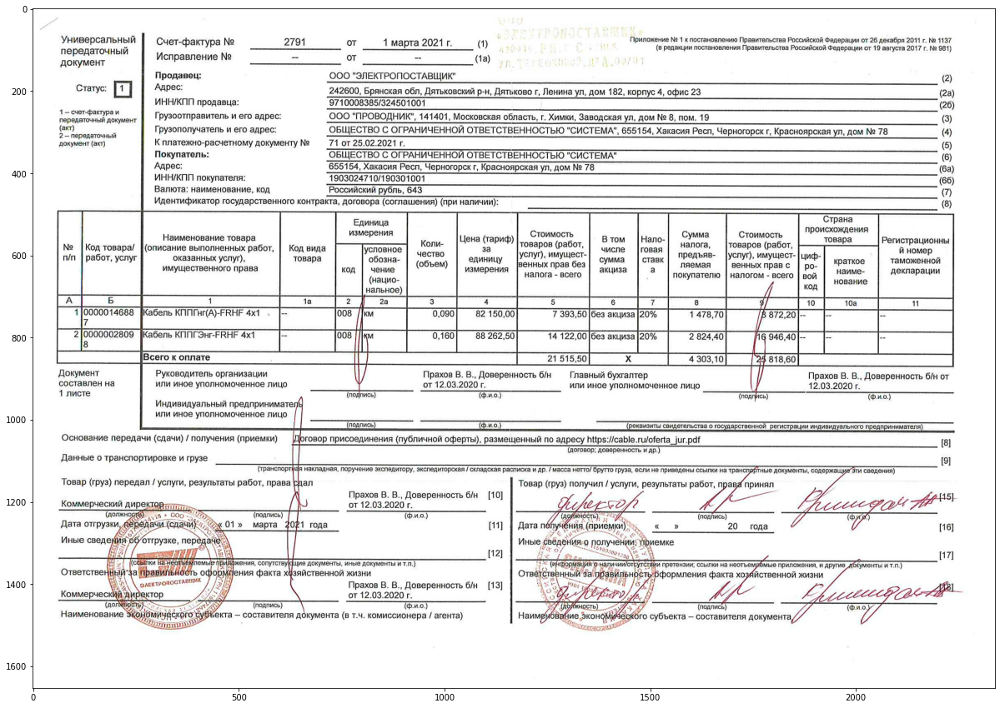

In [ ]:
plotting = plt.imshow(image)
plt.show()

In [ ]:
def getSkewAngle(image) -> float:
    new = image.copy()
    (h, w) = new.shape[:2]
    crop = new[0:int(h/2), 0:int(w/2)]
    gray = cv2.cvtColor(crop, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)

    plotting = plt.imshow(blur)
    plt.show()

    thresh = cv2.threshold(
        blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (23, 25))
    dilate = cv2.dilate(thresh, kernel, iterations=5)

    plotting = plt.imshow(dilate)
    plt.show()

    contours, hierarchy = cv2.findContours(
        dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)

    largestContour = contours[1]
    minAreaRect = cv2.minAreaRect(largestContour)

    angle = minAreaRect[-1]
    if angle < -5 or angle > 5:
        #angle = 90 + angle
        angle = 0
    return angle

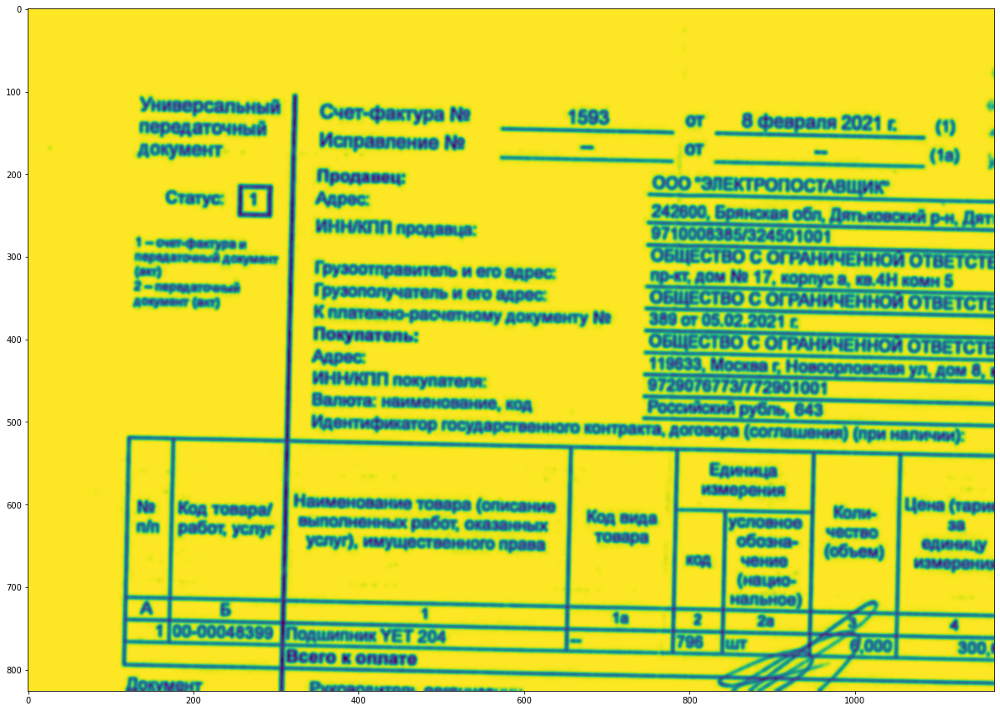

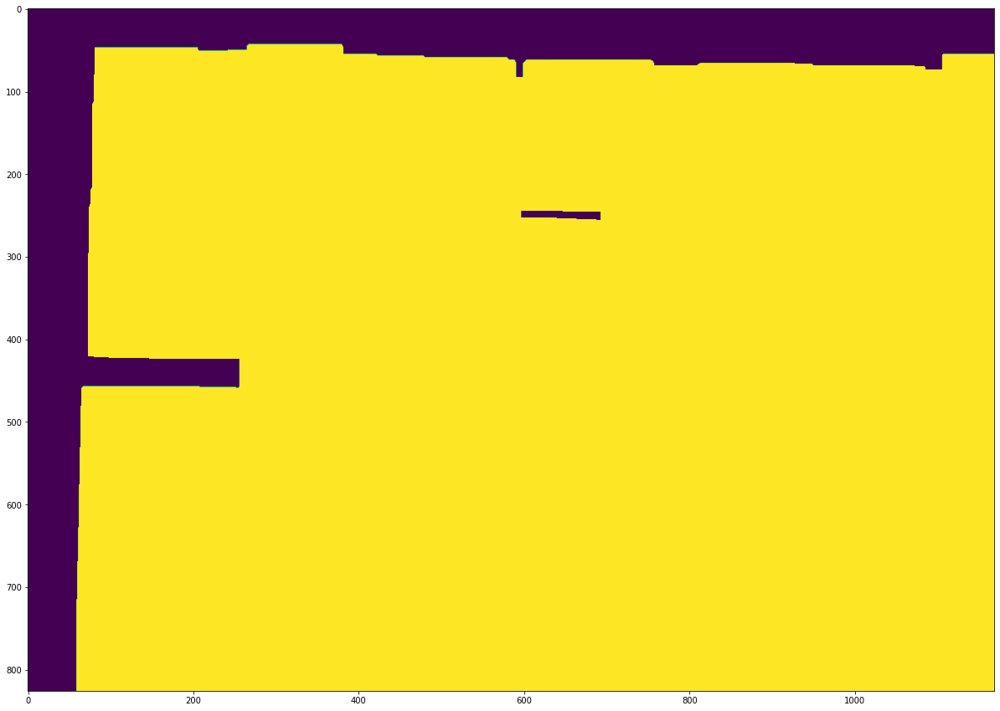

1.2453641891479492
CPU times: user 1.34 s, sys: 26.3 ms, total: 1.37 s
Wall time: 1.4 s


In [ ]:
%%time 
angle = getSkewAngle(image)
print(angle)

In [ ]:
print('OCR Version: ', pytesseract.get_tesseract_version())

OCR Version:  4.0.0-beta.1
 leptonica-1.75.3
  libgif 5.1.4 : libjpeg 8d (libjpeg-turbo 1.5.2) : libpng 1.6.34 : libtiff 4.0.9 : zlib 1.2.11 : libwebp 0.6.1 : libopenjp2 2.3.0

 Found AVX2
 Found AVX
 Found SSE



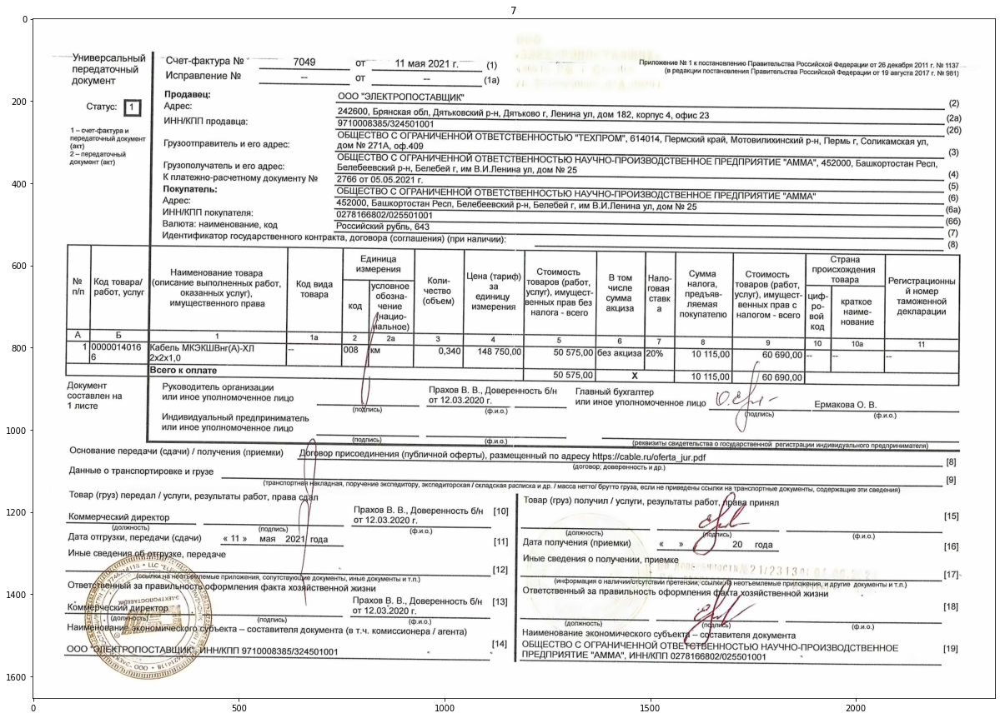

универсальный | ` Счет-фактура №" 7049 от 11 мая2021_— (9 т а О И
документ Исправление № от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г


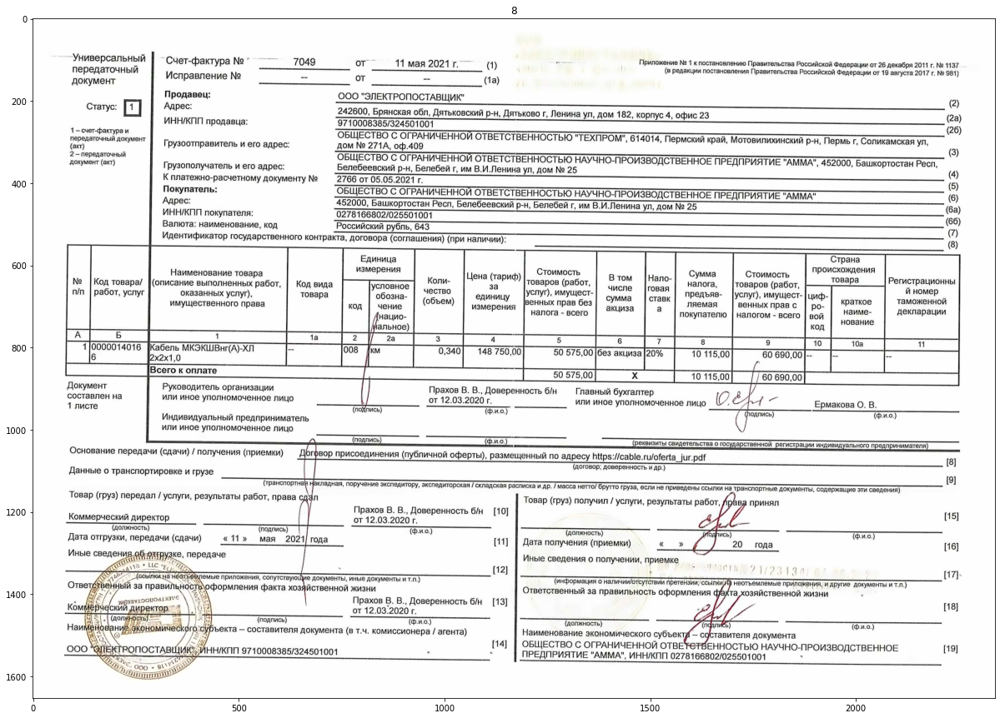

универсальный | ` Счет-фактура №” 7049 от 11 мая 2021г. (1) р р ОНО В
документ Исправление № - от — (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дять


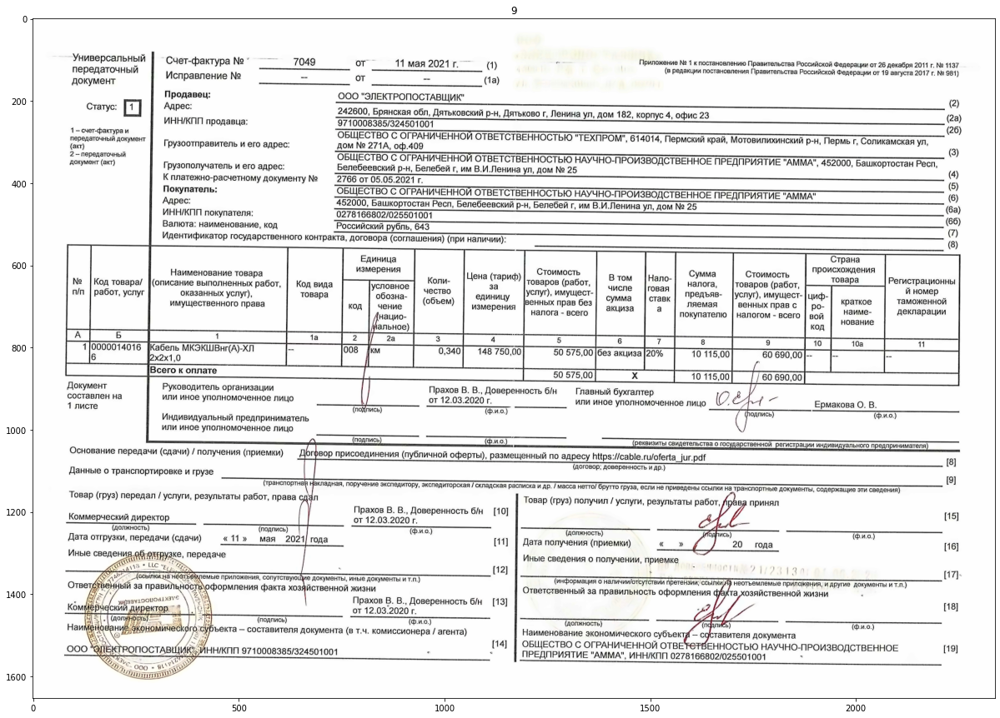

универсальный | ` Счет-фактура №^ _—__ 7049 от 11 мая2021.__ (9 ода п ор О
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н,


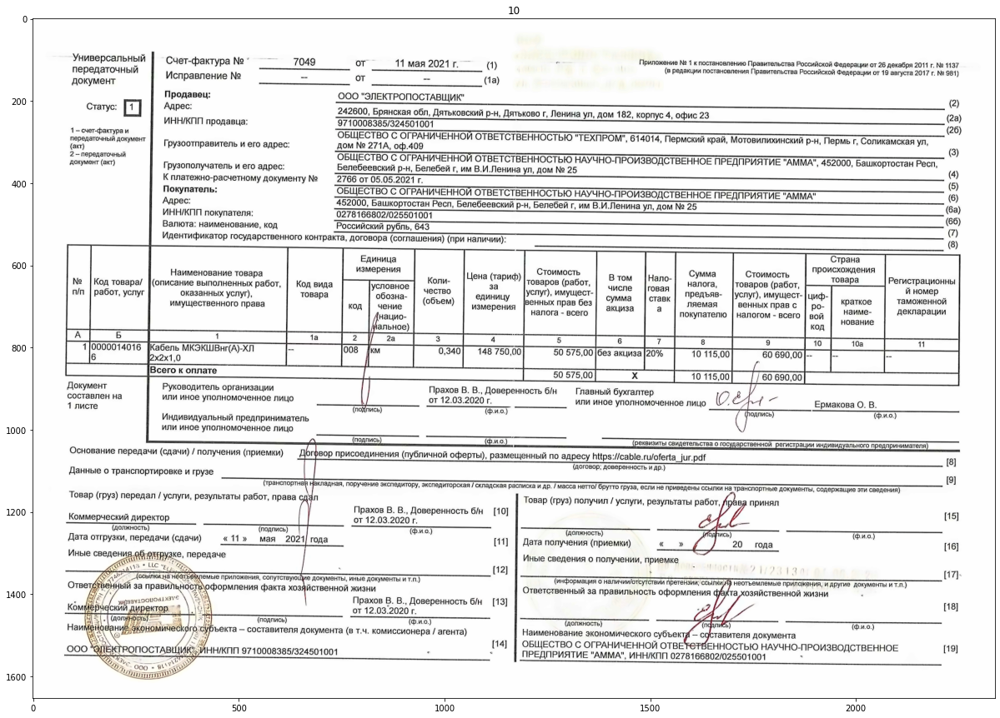

универсальный | Счет-фактура №° ___ 7049 от 11 мая2021. (9 ода п о О
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьк


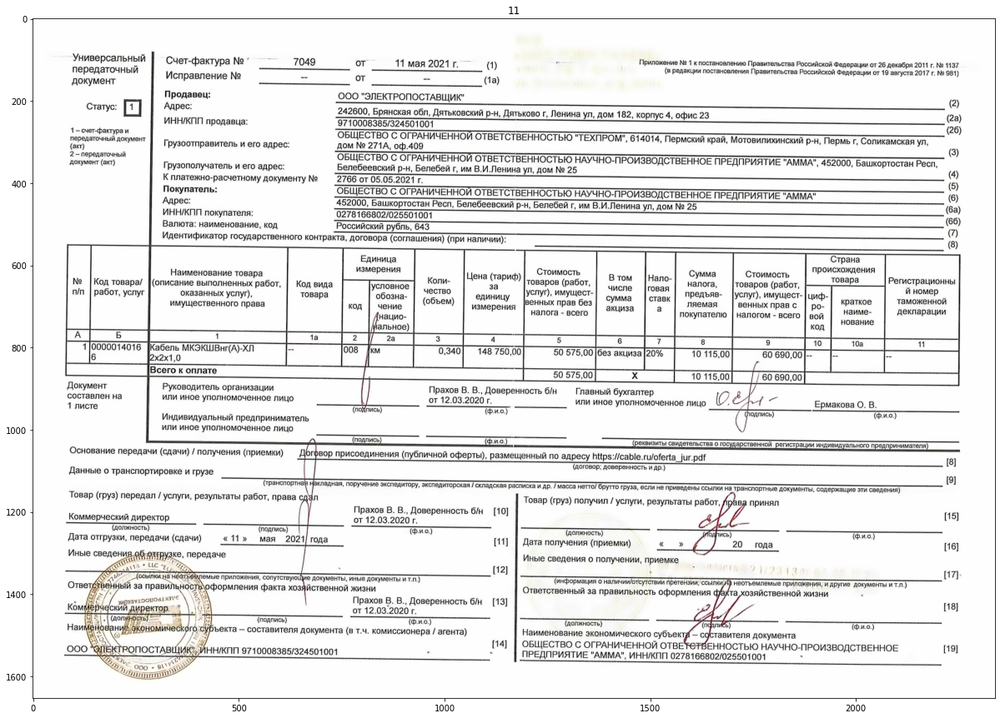

универсальный | Счет-фактура №*° ___ 7049 от 11 мая2021 т. (9 ода п о О
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дя


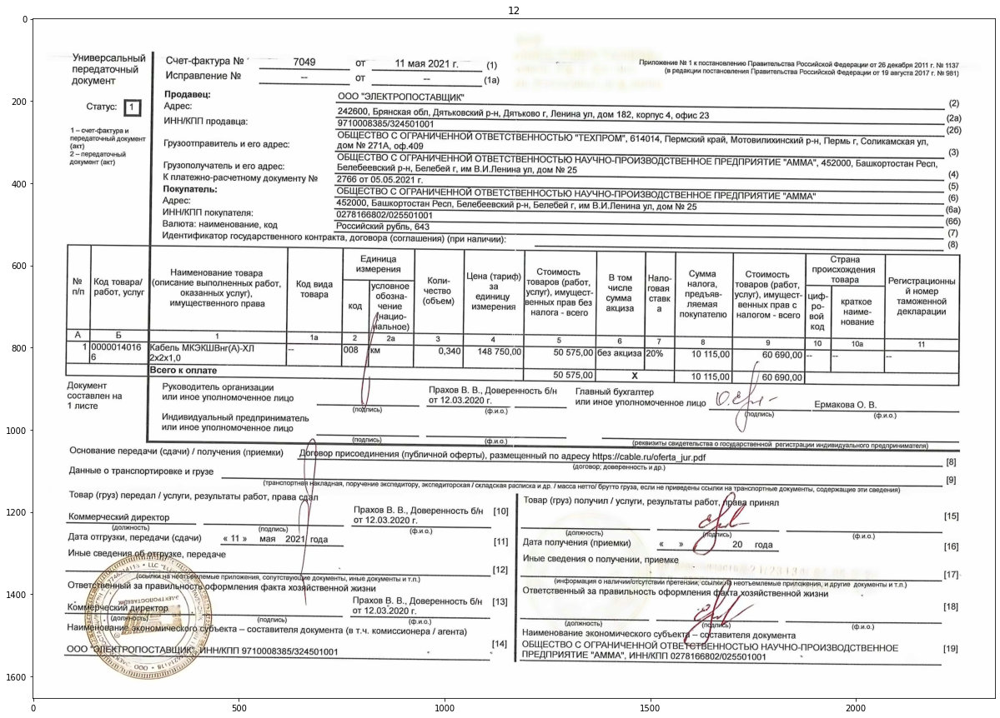

универсальный | Счет-фактура №*° 7049 от 11 мая2021. (9 од по о О
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково


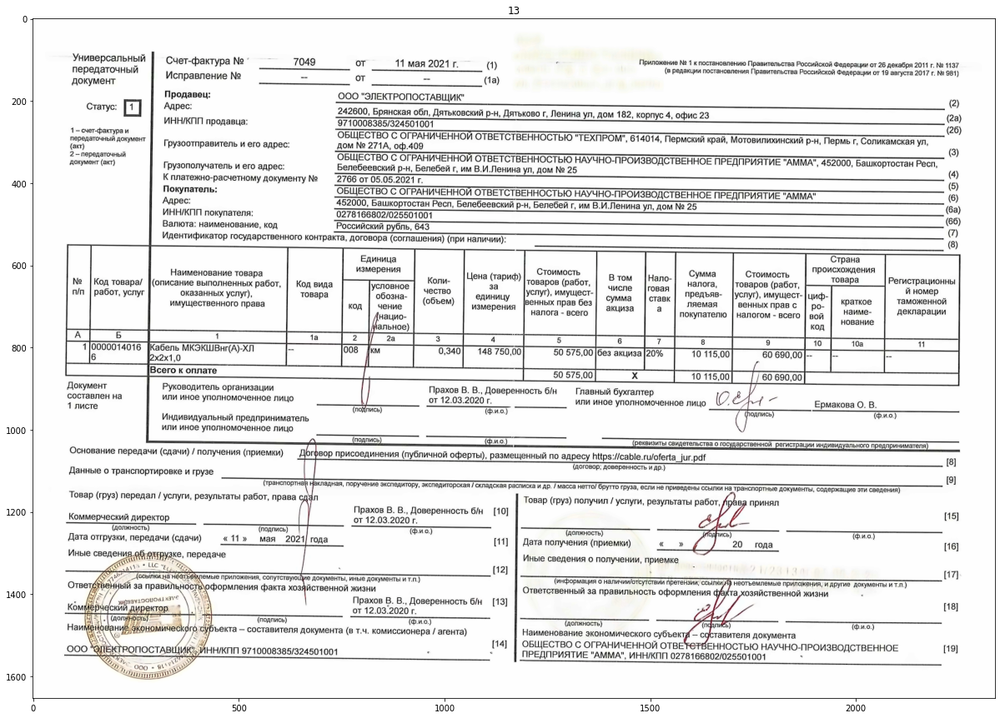

универсальный | Очет«фактура № 7049 от 11 мая2021 т. (9 ода п о О
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково


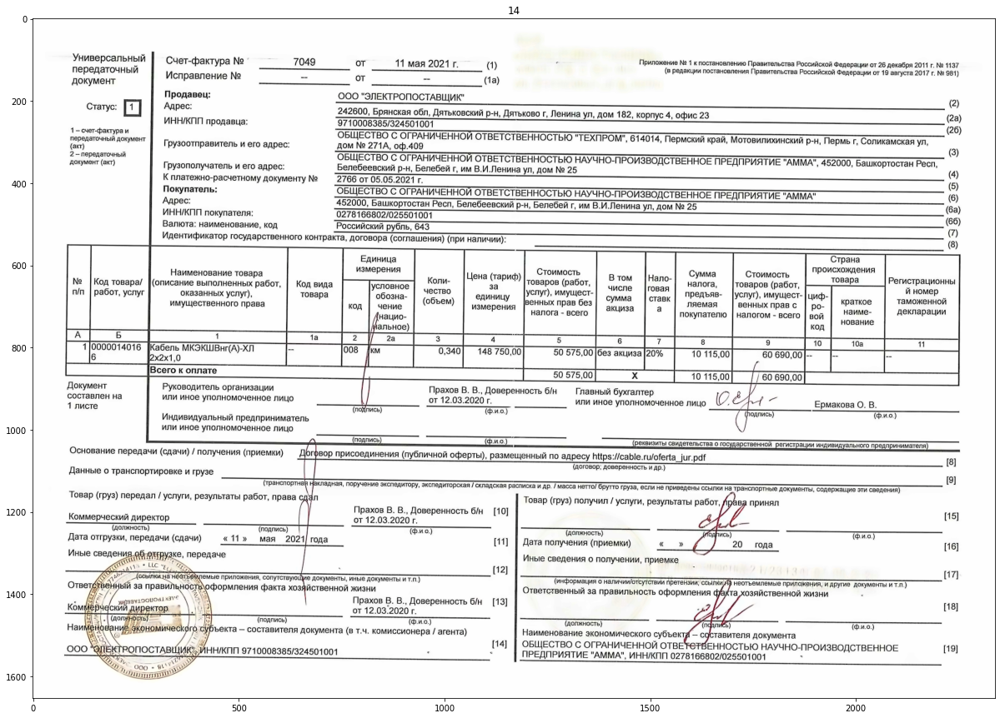

универсальный | Очет«фактура № 7049 от 11 мая2021т. (9 од п о О
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г


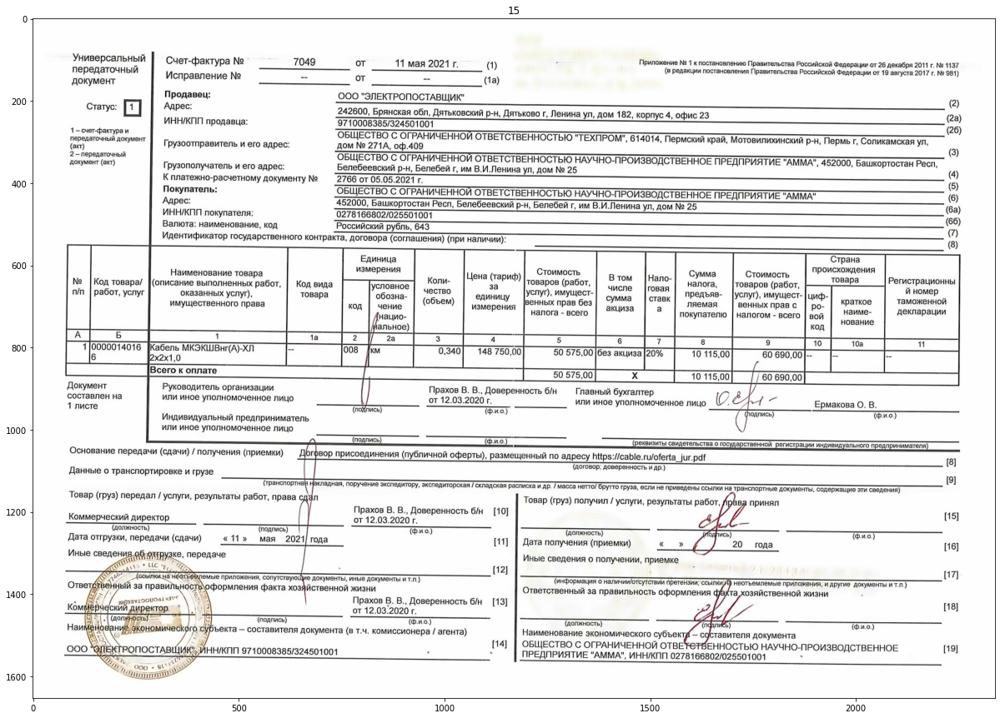

универсальный | Счет-фактура № 7049 от 11 мая2021. (9 о И
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г, Лени


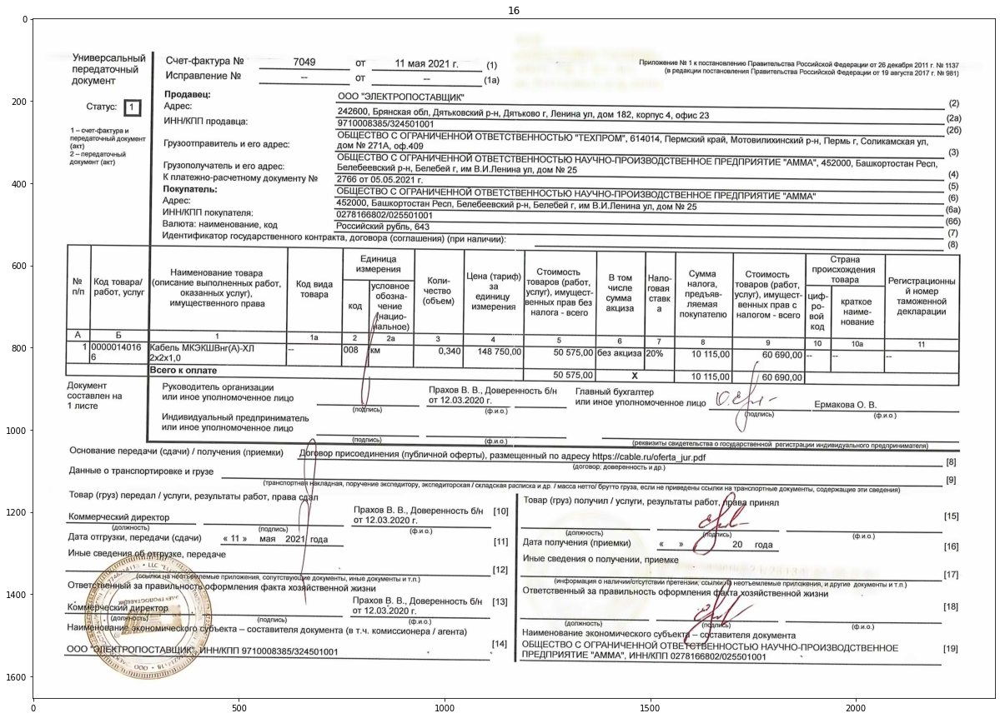

универсальный | Очет-«фактура № 7049 от 11 мая2021 т. (9 о И
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г, Л


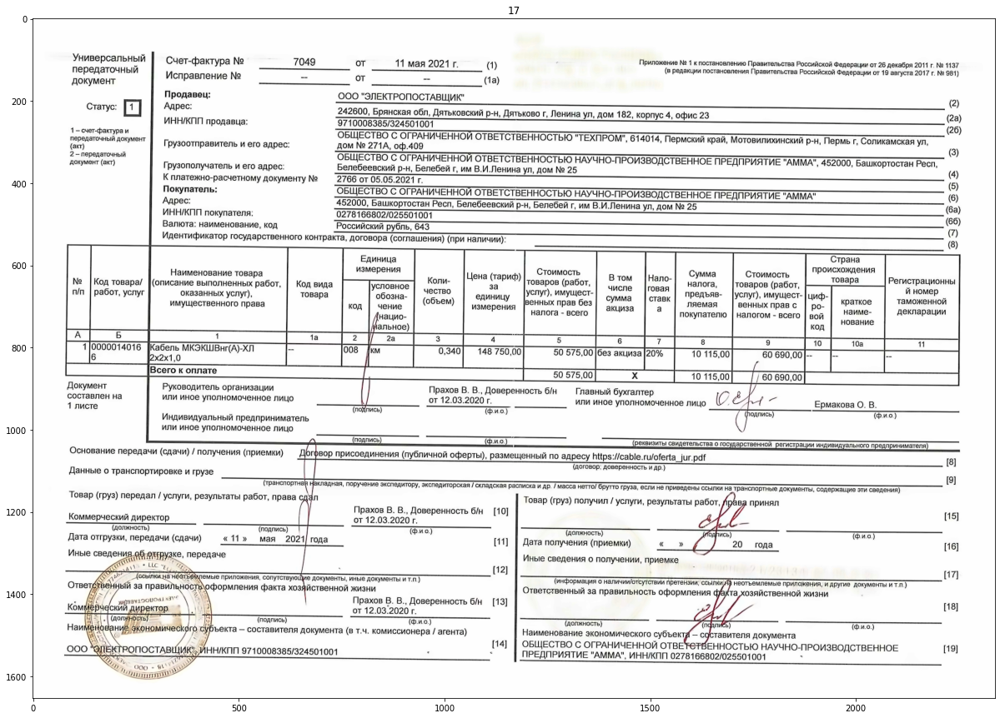

универсальный | Счет-фактура № 7049 от 11 мая2021 г. (9 о о И
документ Исправление № - от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г, 


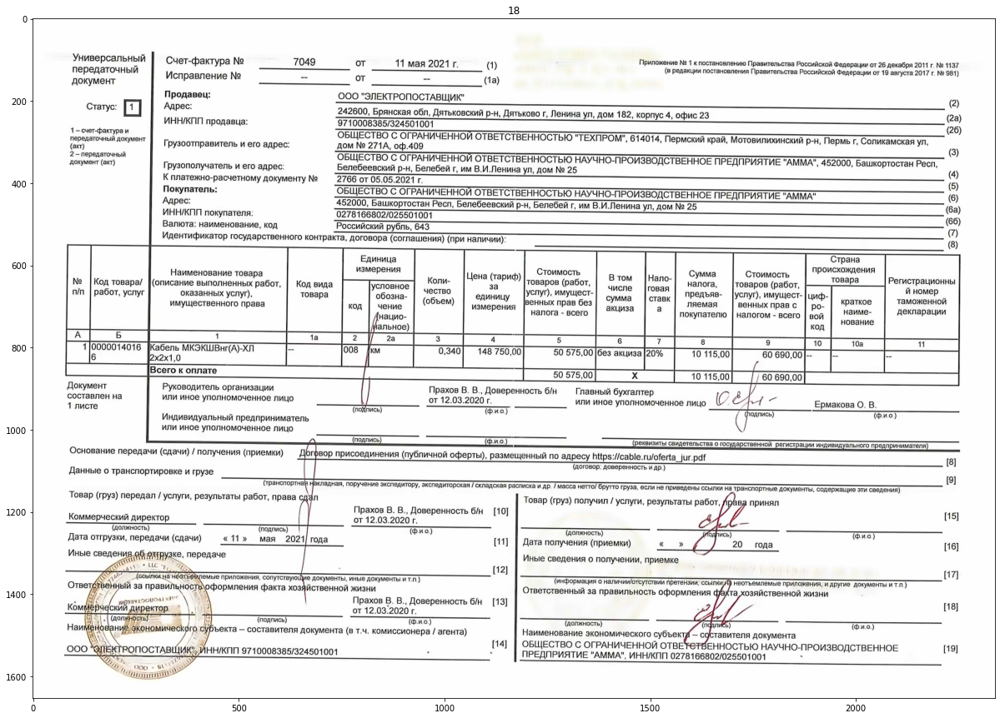

универсальный | Счет-фактура № 7049 от 11 мая2021 г. (9 о о И
документ Исправление № — от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г, 


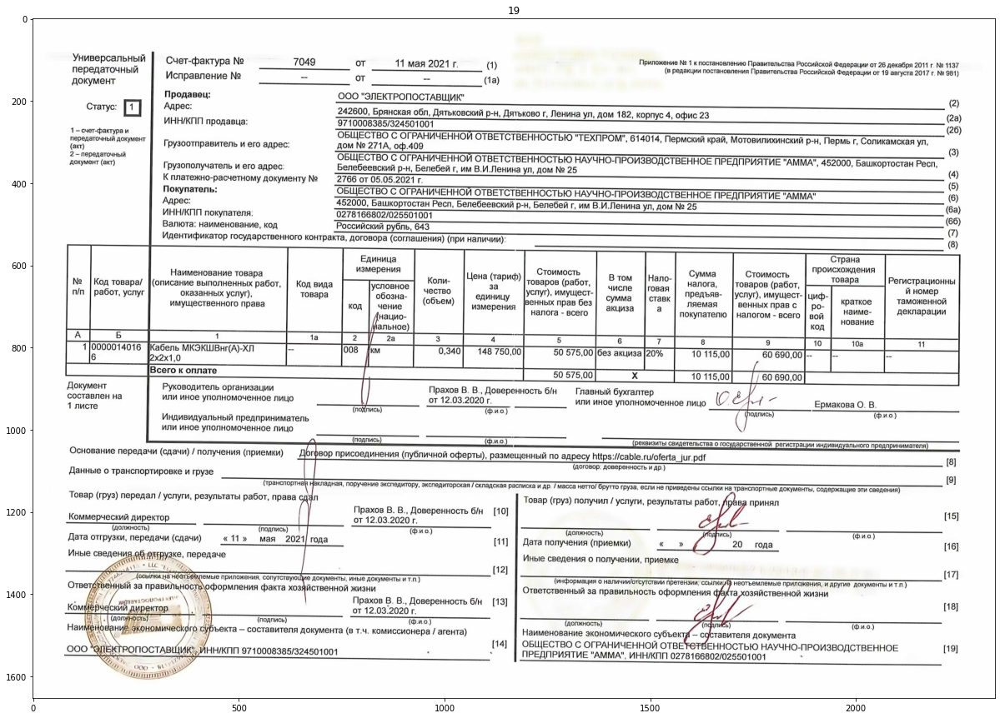

универсальный | Очет«фактура № 7049 от 11 мая2021 г. (9 о о И
документ Исправление № — от = (1а)
Продавец: ООО "ЭЛЕКТРОПОСТАВЩИК" (2)
Статус: Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г, 


In [ ]:
# blur = cv2.GaussianBlur(image,(1,1), 0) 
# mask=cv2.inRange(blur,(0,0,0),(210,210,210))
# res = 255 - mask

#r = cv2.cvtColor(blur, cv2.COLOR_BGR2RGB)
for i in range(7,20):
  n = cv2.fastNlMeansDenoisingColored(image, None, i, 10, 7, 21) 

  text = pytesseract.image_to_string(n, config = '-l rus --psm 6')
  plotting = plt.imshow(n)
  plt.title(i)
  plt.show()
  print(text[:200])

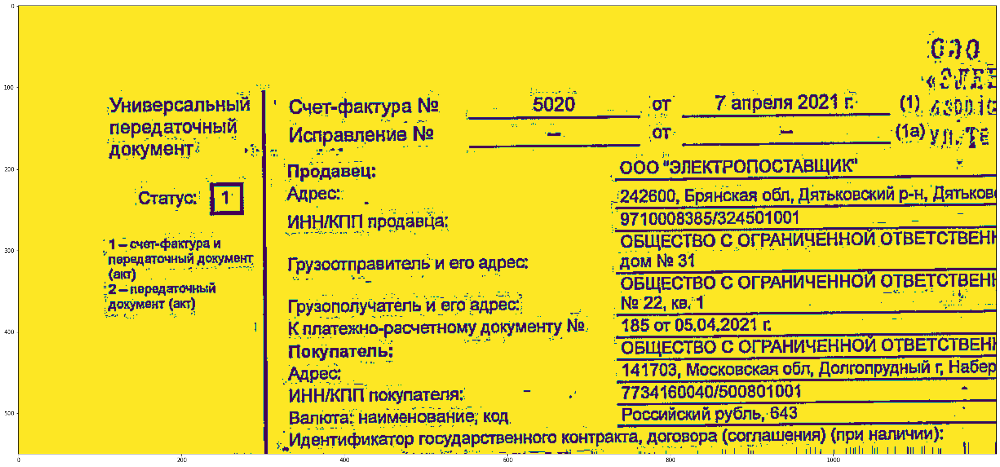

In [ ]:
imgt = cv2.cvtColor(rotated, cv2.COLOR_BGR2GRAY)
imgf = cv2.adaptiveThreshold(imgt,220,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,21,2)
plotting = plt.imshow(imgf)
plt.show()

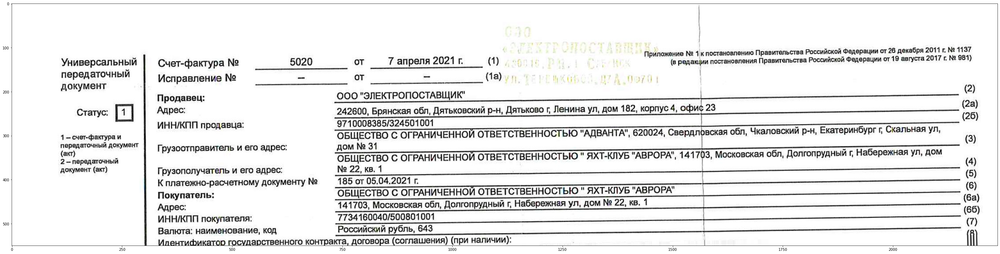

'Универсальный\nпередаточный\nдокумент\n\nСтатус:\n\n1- счет-фактура и\nпередаточный документ\n(акт)\n\n2- передаточный\nдокумент (акт)\n\nПриложение № 1 к постановлению Правительства Российской Федерации от 26 декабря 2011 г. № 1137\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nСчет-фактура № 5020 от 7 апреля 2021 г. (1) (в редакции постановления Правительства Российской Федерации от 19 августа 2017 с № 981)\nИсправление № - от - (1а). еб , 0070 |\nПродавец: 000 "ЭЛЕКТРОПОСТАВЩИК" (2)\nАдрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г; Ленина ул, дом 182, корпус 4, ой 23 (2а)\nИНН/КПП продавца: 9710008385/324501001 (26)\nОБЩЕСТВО С ОГ! РАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ "АДВАНТА", 620024, Ат ‘обл, Чкаловский р-н, Екатеринбург г, Скальная ул,\nГрузоотправитель и его адрес: дом № 31 (3)\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ " ЯХТ-КЛУБ "АВРОРА", 141703, Московская обл, Долгопрудный г Набережная ул, дом\nГрузополучатель и его адрес: № 22, кв. 1 | (4)\nКплатежно-расчетному документу 

In [ ]:
blur = cv2.GaussianBlur(rotated, (1, 1), 0)
plotting = plt.imshow(blur)
plt.show()
pytesseract.image_to_string(blur, config = '-l rus --psm 3')

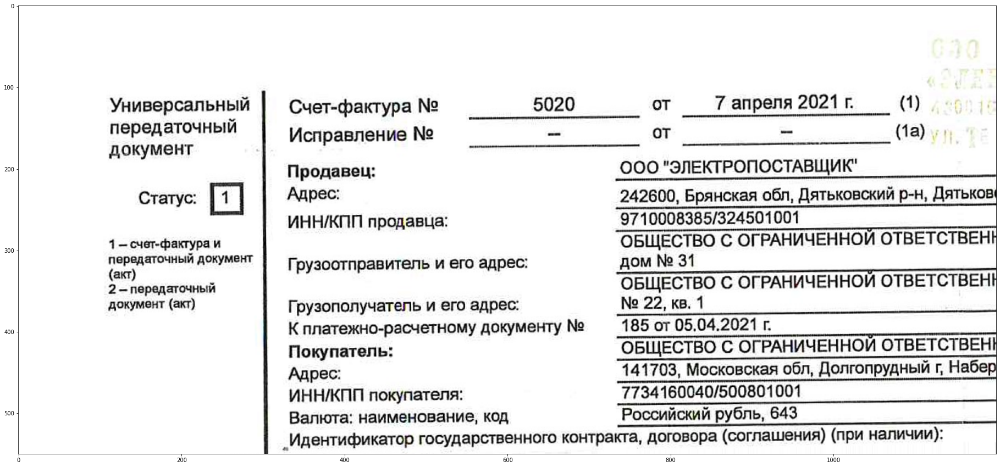

'Универсальный Счет-фактура № 5020 от 7 апреля 2021 г. (1)\nпередаточный ани а\n\n \n\nдокумент Исправление № - от - (1а).\n\nПродавец: 000 "ЭЛЕКТРОПОСТАВЩИК"\nСтатус: П] Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьков\n\nИННКПП продавца: 9710008385/324501001\n\n1 — счет-фактура и ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕН!\n\nеб Аокумент | Грузоотправитель и его адрес: дом № 31\n\n2 - передаточный ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕНЕ\n\nдокумент (акт) Грузополучатель и его адрес: № 22, кв. 1\nКплатежно-расчетному документу № 185 от 05.04.2021 г.\nПокупатель: ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕН!\nАдрес: 141703, Московская обл, Долгопрудный г, Набер\nИНН/КПП покупателя: 7734160040/500801001\nВалюта: наименование, код Российский рубль, 643\n\n_Идентификатор государственного контракта, договора (соглашения) (при наличии):\n\x0c'

In [ ]:
kernel = np.ones((1,1),np.uint8)
dilation = cv2.dilate(blur, kernel, iterations=3)
plotting = plt.imshow(dilation)
plt.show()
pytesseract.image_to_string(dilation, config = '-l rus --psm 3')

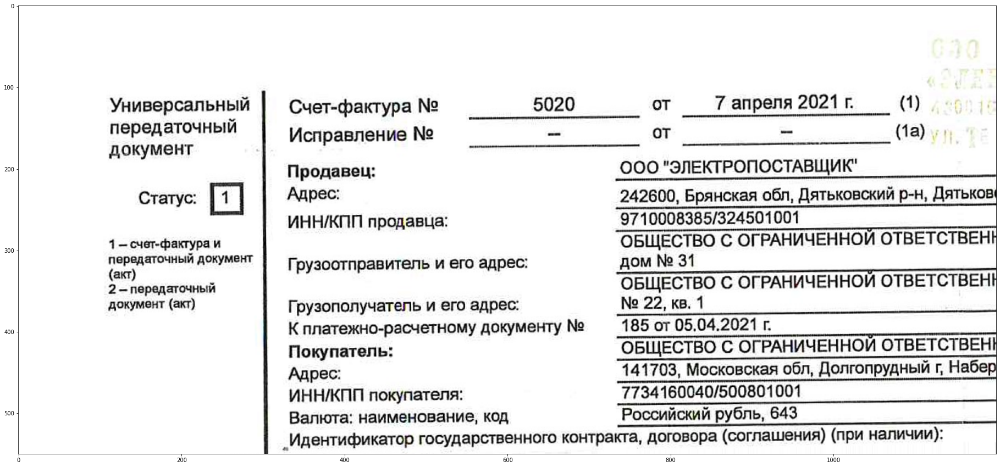

'Универсальный Счет-фактура № 5020 от 7 апреля 2021 г. (1)\nпередаточный ани а\n\n \n\nдокумент Исправление № - от - (1а).\n\nПродавец: 000 "ЭЛЕКТРОПОСТАВЩИК"\nСтатус: П] Адрес: 242600, Брянская обл, Дятьковский р-н, Дятьков\n\nИННКПП продавца: 9710008385/324501001\n\n1 — счет-фактура и ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕН!\n\nеб Аокумент | Грузоотправитель и его адрес: дом № 31\n\n2 - передаточный ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕНЕ\n\nдокумент (акт) Грузополучатель и его адрес: № 22, кв. 1\nКплатежно-расчетному документу № 185 от 05.04.2021 г.\nПокупатель: ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕН!\nАдрес: 141703, Московская обл, Долгопрудный г, Набер\nИНН/КПП покупателя: 7734160040/500801001\nВалюта: наименование, код Российский рубль, 643\n\n_Идентификатор государственного контракта, договора (соглашения) (при наличии):\n\x0c'

In [ ]:
erosion = cv2.erode(dilation, kernel, iterations=1)
plotting = plt.imshow(erosion)
plt.show()
pytesseract.image_to_string(erosion, config = '-l rus --psm 3')

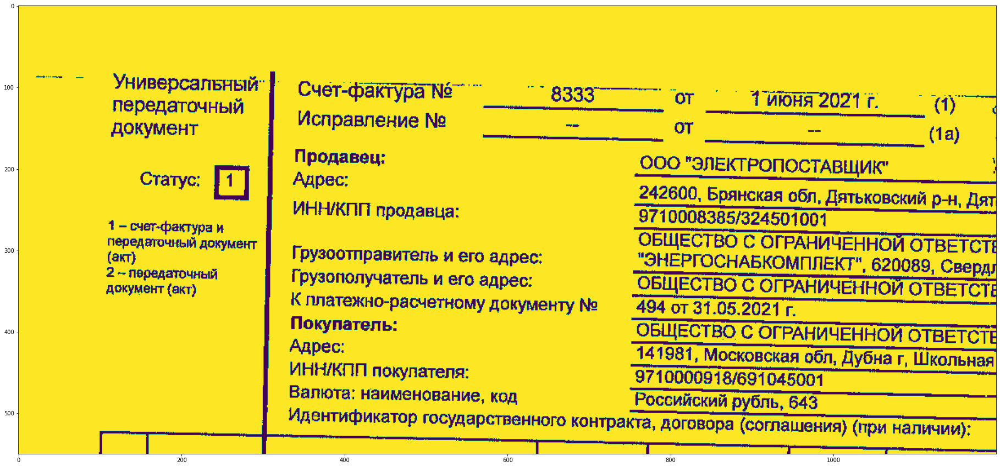

'Универсальный"\n\nпередаточный\nдокумент\n\nСтатус: Е\n\n1 - счет-фактура и\nпередаточный документ\n(акт)\n\n2 -- передаточный\nдокумент (акт)\n\n \n\n \n\nСчет-фактура №” _` 8333 от _ ТИЮНЯ 2024 ®. т?\nЫ— июня\n\nИсправление № — от — (Та)\n——_Ь\n\nПродавец: (000 "ЭЛЕКТРОПОСТАВЩИК" :\n\n1 — и:\nАдрес: 242600, Брянская обл, Дятьковский р-н, Дят\nИННЖКЛП продавца: 9710008385/324501001\n\nГрузоотправитепь и его адрес:\nГрузополучатель и его адрес:\n\nК платежно-расчетному документу №\nПокупатель:\n\nАдрес:\n\nИНН/КПП покупателя:\n\nВалюта: наименование, код\n\nИдентификатор государственного контракта, договора (соглашения) (при наличии):\n\n \n\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТЕ\n"ЭНЕРГОСНАБКОМПЛЕКТ", 620089, Сверд;\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТЕ\n494 от 31.05.2021 г.\n\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТЕ\n141981, Московская обл, Дубна г, Школьная\n9710000918/691045001\n\nРоссийский рубль, 643\n\n \n\x0c'

In [ ]:
erosion_ = cv2.cvtColor(blur, cv2.COLOR_BGR2GRAY)
ret, th = cv2.threshold(erosion_, 190, 255, cv2.THRESH_BINARY)
plotting = plt.imshow(th)
plt.show()
pytesseract.image_to_string(th, config = '-l rus --psm 3')


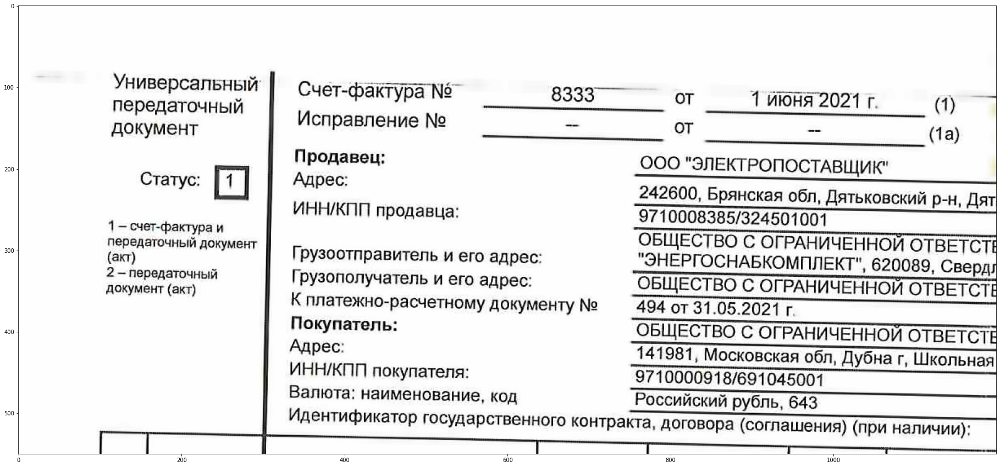

'Универсальный Счет-фактура №- 8333—— от 1 июня 2021 г 9 —\nо 1201г. —\n\n \n\nпередаточный Исправление № — от г (1а)\nдокумент —_—_\nПродавец: 000 "ЭЛЕКТРОПОСТАВЩИК"\nСтатус: ] Адрес: 242600, Брянская обл, Дятьковский р-н, Дят\nИНН/КПП продавца: 9710008385/324501001\n1 — счет-фактура и ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТ!\nНЫ помет | Грузоотправитель и его адрес: "ЭНЕРГОСНАБКОМПЛЕКТ", 620089, Свердх\n2 передаточный Грузополучатель и его адрес: ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТЕ\nлы К платежно-расчетному документу№ —`494 0т31.05.2021 г\nПокупатель: ОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТЕ\nАдрес: 141981, Московская обл, Дубна г, Школьная\nИНН/КПП покупателя: 9710000918/691045001\nВалюта: наименование, код Российский рубль, 643\n\nИдентификатор государственного контракта, договора (соглашения) (при наличии):\n\n   \n\x0c'

In [ ]:
# denoising of image saving it into dst image 
dst = cv2.fastNlMeansDenoisingColored(blur, None, 20, 10, 15, 15) 
# Plotting of source and destination image 
plt.imshow(dst) 
plt.show()
pytesseract.image_to_string(dst, config = '-l rus --psm 3')

In [ ]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
gray = cv2.bitwise_not(gray)
thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)[1]
plotting = plt.imshow(thresh)
plt.show()

In [ ]:
coords = np.column_stack(np.where(thresh > 0))
angle = cv2.minAreaRect(coords)[-1]
print(angle)

-0.0


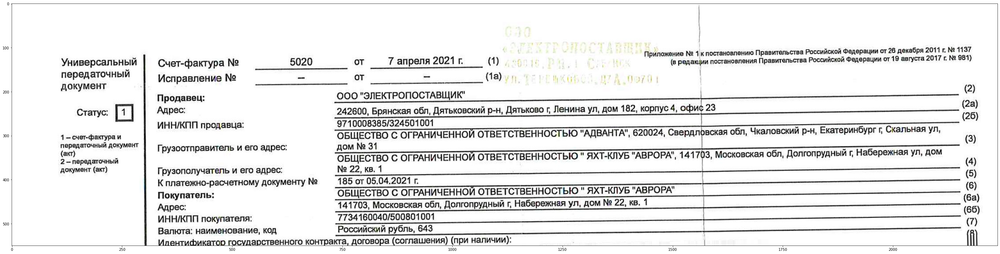

In [ ]:
rotated = rotateImage(image, angle)
plotting = plt.imshow(rotated)
plt.show()

In [ ]:
# Rotate the image around its center
def rotateImage(cvImage, angle: float):
    newImage = cvImage.copy()
    (h, w) = newImage.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    newImage = cv2.warpAffine(newImage, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)
    return newImage

In [ ]:
pytesseract.image_to_string(rotated, config = '-l rus --psm 3')

'Универсальный\nпередаточный\nдокумент\n\nСтатус:\n\n1- счет-фактура и\nпередаточный документ\n(акт)\n\n2- передаточный\nдокумент (акт)\n\nПриложение № 1 к постановлению Правительства Российской Федерации от 26 декабря 2011 г. № 1137\n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\n \n\nСчет-фактура № 5020 от 7 апреля 2021 г. (1) (в редакции постановления Правительства Российской Федерации от 19 августа 2017 с № 981)\nИсправление № - от - (1а). еб , 0070 |\nПродавец: 000 "ЭЛЕКТРОПОСТАВЩИК" (2)\nАдрес: 242600, Брянская обл, Дятьковский р-н, Дятьково г; Ленина ул, дом 182, корпус 4, ой 23 (2а)\nИНН/КПП продавца: 9710008385/324501001 (26)\nОБЩЕСТВО С ОГ! РАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ "АДВАНТА", 620024, Ат ‘обл, Чкаловский р-н, Екатеринбург г, Скальная ул,\nГрузоотправитель и его адрес: дом № 31 (3)\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ " ЯХТ-КЛУБ "АВРОРА", 141703, Московская обл, Долгопрудный г Набережная ул, дом\nГрузополучатель и его адрес: № 22, кв. 1 | (4)\nКплатежно-расчетному документу 

In [ ]:
# Calculate skew angle of an image
def getSkewAngle(cvImage) -> float:
    # Prep image, copy, convert to gray scale, blur, and threshold
    newImage = cvImage.copy()
    gray = cv2.cvtColor(newImage, cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray, (9, 9), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

    # plotting = plt.imshow(thresh)
    # plt.show()

    # Apply dilate to merge text into meaningful lines/paragraphs.
    # Use larger kernel on X axis to merge characters into single line, cancelling out any spaces.
    # But use smaller kernel on Y axis to separate between different blocks of text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (23, 25))
    dilate = cv2.dilate(thresh, kernel, iterations=5)

    # plotting = plt.imshow(dilate)
    # plt.show()
    # Find all contours
    contours, hierarchy = cv2.findContours(dilate, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key = cv2.contourArea, reverse = True)

    # Find largest contour and surround in min area box
    largestContour = contours[1]
    minAreaRect = cv2.minAreaRect(largestContour)

    # Determine the angle. Convert it to the value that was originally used to obtain skewed image
    angle = minAreaRect[-1]
    if angle < -45:
        angle = 90 + angle
    return  angle



1.2453643083572388


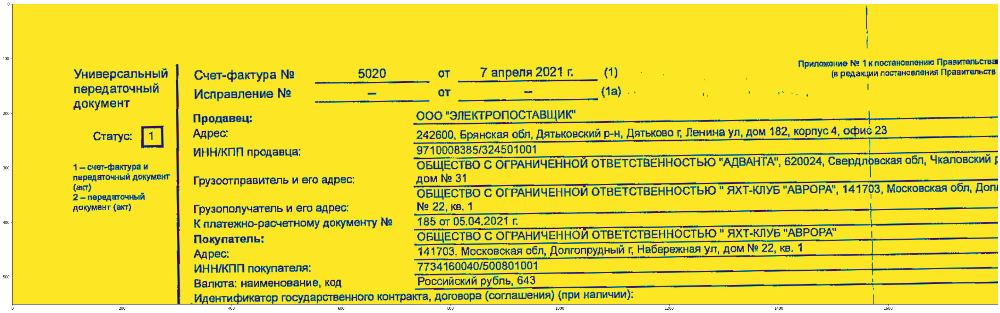

'Универсальный\nпередаточный\nдокумент\n\nСтатус: Г]\n\n1— счет-фактура и\nпередаточный документ\n(акт)\n\n2 - первдаточный\nдокумент (кт)\n\nСчет-фактура № 5020\nИсправление № -\n\n \n\nПродавец:\nАдрес:\nИНН/КПП продавца:\n\nГрузоотправитель и его адрес:\n\nГрузополучатель и его адрес:\n\nК платежно-расчетному документу №\nПокупатель:\n\nАдрес:\n\nИННЖПП покупателя:\n\nВалюта: наименование, код\n\n \n\n|\n\nПриложение № 1 к постановлению Правительства\nИВ 7 апреля 2021 г. (1) (в редакции постановления Правитальств\n\nот - {1а).. , . , . !\n000 "ЭЛЕКТРОПОСТАВЩИК"\n242600, Брянская обл, Дятьковский р-н, Дятьково г, Ленина ул, дом 182, корпус 4, офис 23\n9710008385/324501001 |\n\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ “АДВАНТА", 620024, Свердловская ‘обл, Чкаловский |\nдом № 31\n\n \n\n \n\n„дом №\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ " ЯХТ-КЛУБ “АВРОРА*, 141703, Московская обл, Дол:\n\n№ 22, кв. 1 |\n185 от 05.04.2021 г |\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ " ЯХТ-КЛУБ "АВРО

In [ ]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
adaptiveThresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,
                                       cv2.THRESH_BINARY, 35, 80)
angle = getSkewAngle(adaptiveThresh)
print(angle)
rotated = rotateImage(adaptiveThresh, angle)

blur = cv2.GaussianBlur(rotated, (1, 1), 0)

plotting = plt.imshow(blur)
plt.show()
pytesseract.image_to_string(blur, config = '-l rus --psm 3')

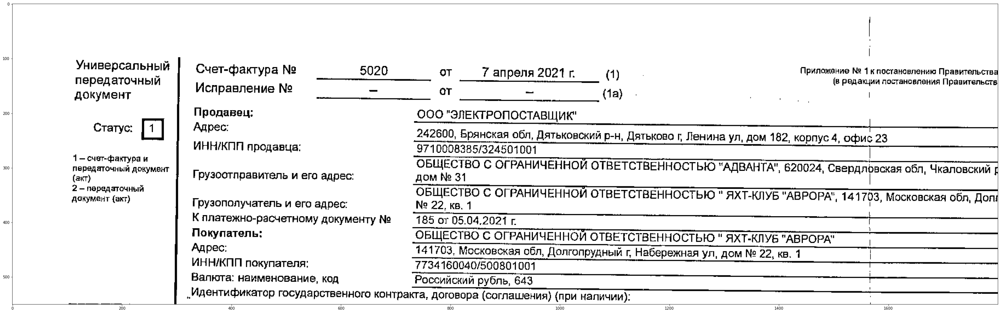

'Универсальный\nпередаточный\nдокумент\n\nСтатус:\n\n \n\n1- счет-фактура и\nпередаточный документ\n(акт)\n\n2 - передаточный\nдокумент (акт)\n\n \n\nСчет-фактура № 5020\nИсправление № -\n\nПродавец;\nАдрес:\nИНН/КПП продавца:\n\nГрузоотправитель и его адрес:\n\nГрузополучатель и его адрес:\n\nК платежно-расчетному документу №\nПокупатель:\n\nАдрес:\n\nИННЖПП покупателя:\n\nВалюта: наименование, код\n\n|\nПриложение № 1 к постановлению Правительства\nот __ 7 апреля 2021 _ (1) ( редакции постановления Правительств\n\nот - {1а) . !\nООО "ЭЛЕКТРОПОСТАВЩИК" |\n\n242600, Брянская обл, Дятьковский р-н, Дятьково г Ленина ул, дом 182, корпус 4, офис 23\n9710008385/324501001 |\n\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ "АДВАНТА", 620024, ‚Свердловская обл, Чкаловский [\nдом № 31\n\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ " ЯХТ-КЛУБ "АВРОРА", 141703, Московская обл, Доп:\n№ 22, кв. 1\n\n185 от 05.04.2021 г.\n\nОБЩЕСТВО С ОГРАНИЧЕННОЙ ОТВЕТСТВЕННОСТЬЮ " ЯХТ-КЛУБ "АВРОРА"\n141703, Московская обл

In [ ]:
rgb = cv2.cvtColor(adaptiveThresh, cv2.COLOR_GRAY2RGB)
plotting = plt.imshow(rgb)
plt.show()
pytesseract.image_to_string(rgb, config = '-l rus --psm 3')